In [10]:
from __future__ import print_function
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.layers import LSTM
from keras.optimizers import RMSprop
from keras.utils.data_utils import get_file
import numpy as np
import random
import sys
from sklearn.cross_validation import train_test_split

In [11]:
with open('subset1/eng.txt','rt') as f:
    text1 = f.read().lower()
with open('subset/frn.txt','rt') as f:
    text2 = f.read().lower()
print('corpus length:', len(text1))
print('corpus length:', len(text2))


corpus length: 10746
corpus length: 12372


In [12]:
y1=np.tile(0,len(text1))
y2 = np.tile(1,len(text2))
x_train_eng, x_test_eng, y_train_eng, y_test_eng = train_test_split(text1, y1, test_size=0.2)
x_train_frn, x_test_frn, y_train_frn, y_test_frn = train_test_split(text2, y2, test_size=0.2)

In [13]:
print(len(x_train_eng), len(x_test_eng))

8596 2150


In [14]:
#generating english model
chars_eng = sorted(list(set(text1)))
chars_fr = sorted(list(set(text2)))
chars = sorted(list(set(chars_eng + chars_fr)))
print('total chars:', len(chars))
char_indices = dict((c, i) for i, c in enumerate(chars))
indices_char = dict((i, c) for i, c in enumerate(chars))


##training set prepare
maxlen= 40
step = 1
sentences_eng_tr = []
next_chars_eng_tr = []
for i in range(0, int(0.8*len(text1)) - maxlen, step):
    sentences_eng_tr.append(text1[i: i + maxlen])
    next_chars_eng_tr.append(text1[i + maxlen])

print('nb sequences:', len(sentences_eng_tr))
##test set prepare
sentences_eng_test = []
string_eng_test= []
step_test=20
for i in range(int(0.8*len(text1)) - maxlen,len(text1) - maxlen-step_test, step_test):
    sentences_eng_test.append(text1[i: i + maxlen])
    string_eng_test.append(text1[i+maxlen:i+maxlen+5])
print('nb sequences:', len(sentences_eng_test))

print('Vectorization...')
X_eng = np.zeros((len(sentences_eng_tr), maxlen, len(chars)), dtype=np.bool)
y_eng = np.zeros((len(sentences_eng_tr), len(chars)), dtype=np.bool)
for i, sentence in enumerate(sentences_eng_tr):
    for t, char in enumerate(sentence):
        X_eng[i, t, char_indices[char]] = 1
    y_eng[i, char_indices[next_chars_eng_tr[i]]] = 1


# build the model: a single LSTM
print('Build model...')
model = Sequential()
model.add(LSTM(128, input_shape=(maxlen, len(chars))))
model.add(Dense(len(chars)))
model.add(Activation('softmax'))

optimizer = RMSprop(lr=0.01)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics = ['accuracy'])

total chars: 53
nb sequences: 8556
nb sequences: 107
Vectorization...
Build model...


In [15]:
#generating french model



##training set prepare
maxlen= 40
step = 1
sentences_fr_tr = []
next_chars_fr_tr = []
for i in range(0, int(0.8*len(text2)) - maxlen, step):
    sentences_fr_tr.append(text2[i: i + maxlen])
    next_chars_fr_tr.append(text2[i + maxlen])

print('nb sequences:', len(sentences_fr_tr))
##test set prepare
sentences_fr_test = []
string_fr_test= []
step_test=20
for i in range(int(0.8*len(text2)) - maxlen,len(text2) - maxlen, step_test):
    sentences_fr_test.append(text2[i: i + maxlen])
    string_fr_test.append(text2[i+maxlen:i+maxlen+5])
print('nb sequences:', len(sentences_fr_test))

print('Vectorization...')
X_fr = np.zeros((len(sentences_fr_tr), maxlen, len(chars)), dtype=np.bool)
y_fr = np.zeros((len(sentences_fr_tr), len(chars)), dtype=np.bool)
for i, sentence in enumerate(sentences_fr_tr):
    for t, char in enumerate(sentence):
        X_fr[i, t, char_indices[char]] = 1
    y_fr[i, char_indices[next_chars_fr_tr[i]]] = 1


# build the model: a single LSTM
print('Build model...')
model2 = Sequential()
model2.add(LSTM(128, input_shape=(maxlen, len(chars))))
model2.add(Dense(len(chars)))
model2.add(Activation('softmax'))

optimizer = RMSprop(lr=0.01)
model2.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=["accuracy"])

nb sequences: 9857
nb sequences: 124
Vectorization...
Build model...


In [19]:
import csv
sentences_fr_test =sentences_fr_test[:100]
string_fr_test=string_fr_test[:100]
sentences_eng_test =sentences_eng_test[:100]
string_eng_test=string_eng_test[:100]

sentences_test = sentences_fr_test + sentences_eng_test
string_test = string_fr_test + string_eng_test
print(string_test)
with open("test_originalfrn.csv", 'wt') as f:
    w = csv.writer(f, dialect='excel')
    #for row in string_test:
    w.writerow(string_test)

['ent n', 'iage ', ', jou', '\xaame p', 'le. a', 'ute p', ' \xc3\xa0 l', '\xc3\xa9duc', 'e gra', ' en c', "l'ens", 'menta', 'tal. ', '\xc3\xa9l\xc3\xa9', 'ligat', 'ement', '\x0cprof', '\xc3\xaatre', " l'ac", 's sup', '\xc3\xaatre', 'ne \xc3\xa9', ' en f', ' m\xc3\xa9r', 'ation', 'plein', 't de ', '\xa9 hum', 'orcem', 'des d', 'e et ', 'ondam', 'oit f', 'pr\xc3\xa9h', '\xa9ranc', 'entre', 'ions ', 'upes ', 'gieux', 'd\xc3\xa9ve', 'ctivi', 's uni', 'tien ', 'les p', ' prio', ' de c', " d'\xc3\xa9", 'ner \xc3', '.\n\nar', 'te pe', 'it de', 'ibrem', 'ultur', 'unaut', 's art', 'per a', 'ntifi', 'faits', 'ent 2', 't \xc3\xa0 ', 'es in', ' et m', 'ulant', 'ction', 'litt\xc3', 'tique', 'auteu', 'oute ', 't \xc3\xa0 ', 'sur l', 't sur', 'ation', 'l que', 'liber', 'dans ', '\xa9clar', 'y tro', 't. ar', 'ndivi', 's env', 't\xc3\xa9 d', 'ul le', ' d\xc3\xa9v', 'a per', 'possi', 'exerc', 'ts et', 'ance ', 's, ch', 'is qu', 's \xc3\xa9t', 'oi ex', 'vue\n\n', 'econn', 'respe', 't lib', ' et a', 're a

In [16]:
def vectorize(sentence, chars , char_indices ):
    X = np.zeros((1, maxlen, len(chars)), dtype=np.bool)
    for t, char in enumerate(sentence):
        X[0, t, char_indices[char]] = 1
    return X

In [8]:
def get_scores_for_model(seed,next_string, model,chars,char_indices):
    sentence =seed
    prob_char=0.0
    x = np.zeros((5, maxlen, len(chars)))

    x[0] = vectorize(seed,chars,char_indices)
    x[1] = vectorize(seed[1:]+next_string[:1],chars,char_indices)
    x[2] = vectorize(seed[2:]+next_string[:2],chars,char_indices)
    x[3] = vectorize(seed[3:]+next_string[:3],chars,char_indices)
    x[4] = vectorize(seed[4:]+next_string[:4],chars,char_indices)
    probs_term = []
    for i in range(5):
        preds = model.predict(x[i].reshape(1,40,44), verbose=0)[0]
        preds = np.log(preds)
        probs_term.append(preds[char_indices[next_string[i]]])

    return probs_term
    '''
    prob_list.append(term_probs)
    
    for i in range(5):
        x = np.zeros((1, len(seed), len(chars)))
        for t, char in enumerate(sentence):
            x[0, t, char_indices[char]] = 1.
        preds = model.predict(x, verbose=0)[0]
        #print('Preds', preds)
        diversity = 1.0
        #print(seed, "\n", next_string)
        prob_char = prob_char + sample(preds, diversity,next_string[i],char_indices)
        sentence = sentence[1:] + next_string[i]
    '''
    return np.exp(prob_char)
        

In [ ]:
import csv
# train the model, output generated text after each iteration
for iteration in range(1, 21):
    print()
    #print('-' * 50)
    print('Iteration', iteration)
    a1=model.fit(X_eng, y_eng,
              batch_size=128,
              epochs=50)
    model_eng_json = model.to_json()
    with open("model/model_eng_"+str(iteration)+".json", "w") as json_file:
        json_file.write(model_eng_json)
    # serialize weights to HDF5
    model.save_weights("weights/model_eng_"+ str(iteration) +".h5")
    print("Saved model to disk")

    sentences_fr_test =sentences_fr_test[:100]
    string_fr_test=string_fr_test[:100]
    sentences_eng_test =sentences_eng_test[:100]
    string_eng_test=string_eng_test[:100]
    
    #sentence=
    prob_english=[]
    for i in range(len(sentences_eng_test)):
        prob_english.append(get_scores_for_model(sentences_eng_test[i], string_eng_test[i], model,chars, char_indices))
    for i in range(len(sentences_fr_test)):
        prob_english.append(get_scores_for_model(sentences_fr_test[i], string_fr_test[i], model, chars, char_indices))
    #sentence = text1[start_index: start_index + maxlen]
    #print (prob_english)

    with open("prob_eng/output_prob_" + str(iteration) + ".csv", 'wt') as f:
        w = csv.writer(f, dialect='excel')
        for row in prob_english:
            w.writerow(row)
    with open("model/loss_eng" + ".csv", 'a') as f:
        w = csv.writer(f, dialect='excel')
        w.writerow(a1.history['loss'])
       
        #print()


Iteration 1
Epoch 1/50
8556/8556 [==============================] - 27s - loss: 2.8452 - acc: 0.1992          

/Users/akankshabindal/anaconda/envs/env/lib/python2.7/site-packages/ipykernel/__main__.py:14: RuntimeWarning: divide by zero encountered in log



Iteration 2
Epoch 1/50
8556/8556 [==============================] - 24s - loss: 0.2377 - acc: 0.9202     

In [511]:

import csv
# train the model, output generated text after each iteration


for iteration in range(1, 21):
    print()
    #print('-' * 50)
    print('Iteration', iteration)
    a2=model2.fit(X_fr, y_fr,
              batch_size=128,
              epochs=50)
    model_fr_json = model2.to_json()
    with open("model/model_fr_"+str(iteration)+".json", "w") as json_file:
        json_file.write(model_fr_json)
    # serialize weights to HDF5
    model2.save_weights("weights/model_fr_"+ str(iteration) +".h5")
    print("Saved model to disk")

        
    sentences_fr_test =sentences_fr_test[:100]
    string_fr_test=string_fr_test[:100]
    sentences_eng_test =sentences_eng_test[:100]
    string_eng_test=string_eng_test[:100]
    #sentence=
    prob_fr=[]
    for i in range(len(sentences_eng_test)):
        prob_fr.append(get_scores_for_model(sentences_eng_test[i], string_eng_test[i], model2,chars, char_indices))
    for i in range(len(sentences_fr_test)):
        prob_fr.append(get_scores_for_model(sentences_fr_test[i], string_fr_test[i], model2, chars, char_indices))
    #sentence = text1[start_index: start_index + maxlen]
    #print (prob_english)
    with open("prob_fr/output_prob_" + str(iteration) + ".csv", 'wt') as f:
        w = csv.writer(f, dialect='excel')
        for row in prob_fr:
            w.writerow(row)
    with open("model/loss_fr" + ".csv", 'a') as f:
        w = csv.writer(f, dialect='excel')
        w.writerow(a2.history['loss'])

    #print()


Iteration 1
Epoch 1/50
9567/9567 [==============================] - 18s - loss: 2.1471 - acc: 0.3627     

/Users/akankshabindal/anaconda/envs/env/lib/python2.7/site-packages/ipykernel/__main__.py:14: RuntimeWarning: divide by zero encountered in log



Iteration 2
Epoch 1/50
9567/9567 [==============================] - 16s - loss: 0.2567 - acc: 0.9179     

In [124]:
from keras.models import model_from_json
json_file = open('model/model_eng_2.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model3 = model_from_json(loaded_model_json)
# load weights into new model
model3.load_weights("weights/model_eng_2.h5")
print("Loaded model from disk")
optimizer = RMSprop(lr=0.01)
model3.compile(loss='categorical_crossentropy', optimizer=optimizer)
# evaluate loaded model on test data
#loaded_model.compile(loss='binary_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

Loaded model from disk


In [193]:
from keras.models import model_from_json
json_file = open('model/model_eng_1.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model3 = model_from_json(loaded_model_json)
model3.load_weights("eng.h5")

In [194]:
for diversity in [ 1.0]:
    print()
    #print('----- diversity:', diversity)

    sentences_fr_test =sentences_fr_test[:100]
    string_fr_test=string_fr_test[:100]
    sentences_eng_test =sentences_eng_test[:100]
    string_eng_test=string_eng_test[:100]
    #sentence=
    prob_fr=[]
    for i in range(len(sentences_fr_test)):
        prob_fr.append(get_scores_for_model(sentences_eng_test[i], string_eng_test[i], model3,chars, char_indices))
    for i in range(len(sentences_fr_test)):
        prob_fr.append(get_scores_for_model(sentences_fr_test[i], string_fr_test[i], model3, chars, char_indices))
    #sentence = text1[start_index: start_index + maxlen]
    #print (prob_english)
    with open("prob_eng/output_prob_" + str(1) + ".csv", 'wt') as f:
        w = csv.writer(f, dialect='excel')
        w.writerow(prob_fr)


In [24]:
def predict_language(prob_english, prob_fr):
    y = [1] * len(prob_english)
    probs_eng = []
    probs_frn = []
    for i in range(len(prob_english)):
        sum_english = 0
        sum_fr = 0
        for j in range(len(prob_english[0])):
            sum_english += float(prob_english[i][j])
            sum_fr += float(prob_fr[i][j])
        sum_english = np.exp(sum_english)
        sum_fr = np.exp(sum_fr)
        if sum_english < sum_fr:
            y[i] = 0
        if sum_fr == 0.0:
            sum_fr = 0.0000000001
            #print(str(i) + "Zero")
        probs_eng.append(sum_english)
        probs_frn.append(sum_fr)
    return y, probs_eng, probs_frn

----------------- Iteration: 1 --------------------
3.23962898601e-41 0.992671266453
[[87 13]
 [ 9 91]]
0.89


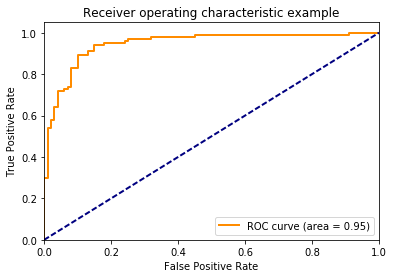

----------------- Iteration: 2 --------------------
2.80987375898e-49 0.999522422796
[[85 15]
 [ 8 92]]
0.885


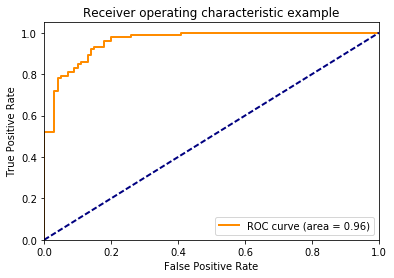

----------------- Iteration: 3 --------------------
3.05320081126e-59 0.99848318488
[[85 15]
 [ 9 91]]
0.88


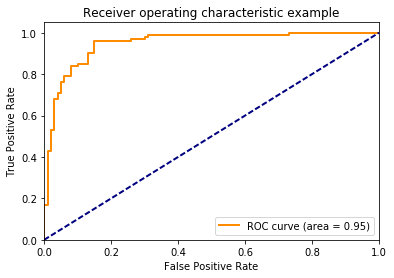

----------------- Iteration: 4 --------------------
8.29958709215e-62 0.999785435413
[[80 20]
 [ 8 92]]
0.86


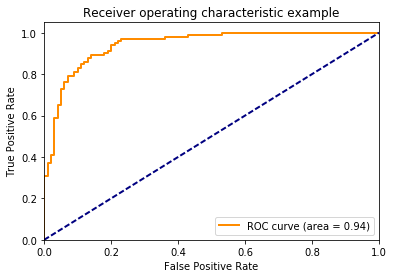

----------------- Iteration: 5 --------------------
8.24272676833e-56 0.999958515833
[[77 23]
 [11 89]]
0.83


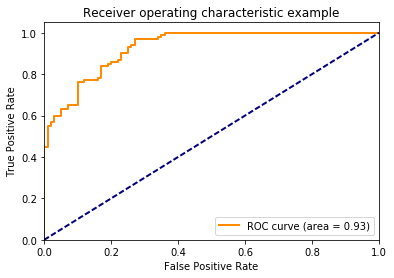

----------------- Iteration: 6 --------------------
2.43604486126e-62 0.999638090331
[[83 17]
 [12 88]]
0.855


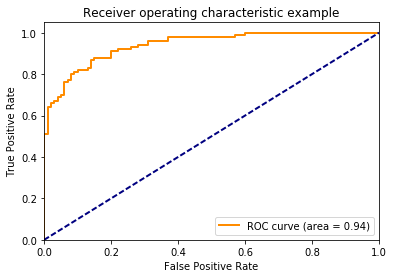

----------------- Iteration: 7 --------------------
4.06669668505e-65 0.999983668403
[[81 19]
 [17 83]]
0.82


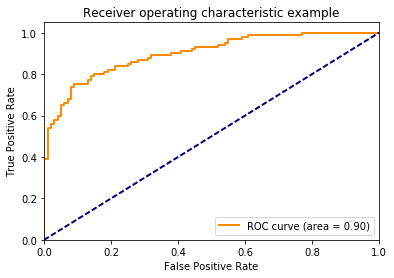

----------------- Iteration: 8 --------------------
1.26878088908e-70 0.99992466137
[[75 25]
 [17 83]]
0.79


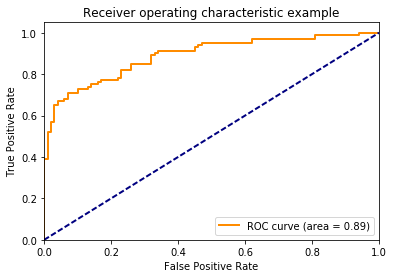

----------------- Iteration: 9 --------------------
6.06079426682e-63 0.999999523163
[[79 21]
 [18 82]]
0.805


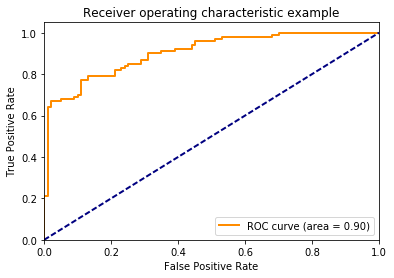

----------------- Iteration: 10 --------------------
6.62516865353e-53 0.999990940111
[[78 22]
 [15 85]]
0.815


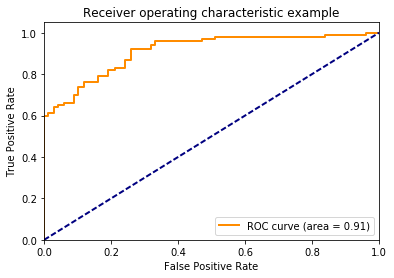

----------------- Iteration: 11 --------------------
9.50982953536e-64 0.999998450284
[[75 25]
 [12 88]]
0.815


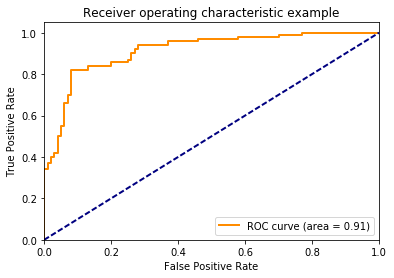

----------------- Iteration: 12 --------------------
1.52287025757e-74 0.999966621697
[[77 23]
 [14 86]]
0.815


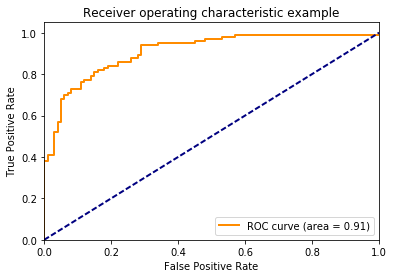

----------------- Iteration: 13 --------------------
5.79335625989e-73 0.999737925439
[[79 21]
 [14 86]]
0.825


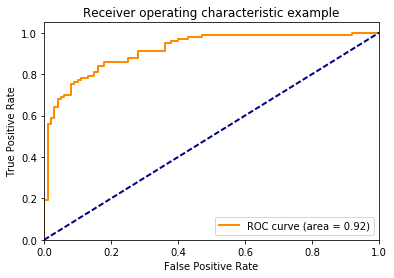

----------------- Iteration: 14 --------------------
5.48178646235e-65 0.999968528786
[[77 23]
 [14 86]]
0.815


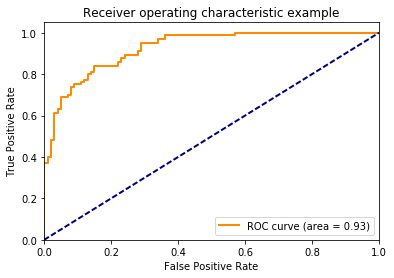

----------------- Iteration: 15 --------------------
1.85360250325e-65 0.999961734066
[[78 22]
 [17 83]]
0.805


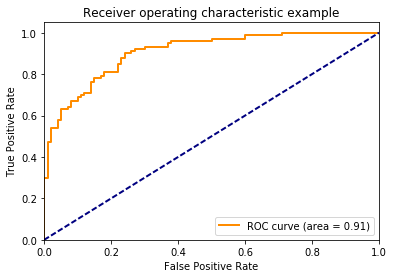

----------------- Iteration: 16 --------------------
2.4356197232e-67 0.999950170883
[[78 22]
 [20 80]]
0.79


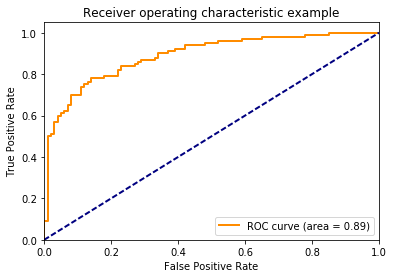

----------------- Iteration: 17 --------------------
9.63759326928e-69 0.999948143989
[[78 22]
 [18 82]]
0.8


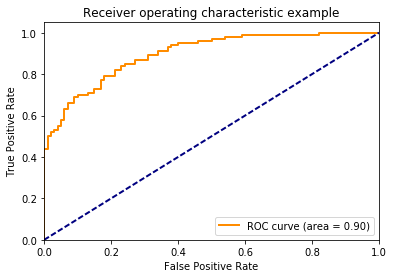

----------------- Iteration: 18 --------------------
1.58899330251e-61 0.999997377398
[[80 20]
 [13 87]]
0.835


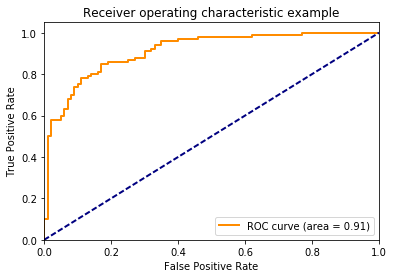

----------------- Iteration: 19 --------------------
4.67575511974e-61 0.999970197868
[[83 17]
 [16 84]]
0.835


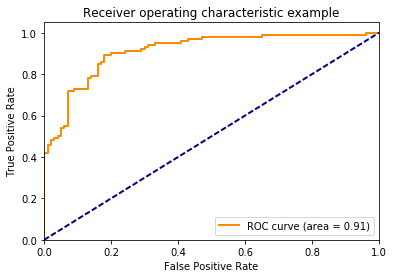

----------------- Iteration: 20 --------------------
1.09282525901e-68 0.999948859698
[[86 14]
 [16 84]]
0.85


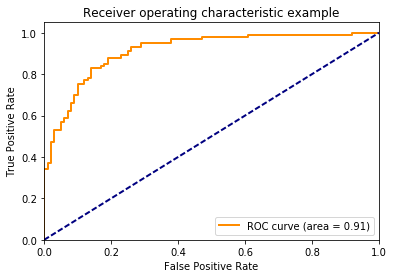

In [25]:
import csv
for iter in range(1,21):
    print("----------------- Iteration: " + str(iter) + " --------------------")
    prob_english=[]
    with open("prob_eng/output_prob_" + str(iter) + ".csv", 'rt') as f:
            w = csv.reader(f, delimiter=',')
            prob_english = list(w)

    prob_fr=[]
    with open("prob_fr/output_prob_" + str(iter) + ".csv", 'rt') as f:
            w = csv.reader(f, delimiter=',')
            prob_fr = list(w)
    
    #print((prob_english), len(prob_fr))
    true_labels = ([1] * 100) + ([0] * 100)
    #print(true_labels.shape)

    from sklearn.metrics import roc_auc_score, confusion_matrix, accuracy_score, auc, roc_curve
    #try:
    pred_y, logprob_english, logprob_fr = predict_language(prob_english, prob_fr)
    #except:
    #    continue
    #x = [e for i, e in enumerate(logprob_fr) if e == 0]
    #print(x)
    print(min(logprob_fr), max(logprob_fr))
    y_hat = np.array([a/b for (a, b) in zip(logprob_english, logprob_fr)])
    #roc_auc_score(true_labels, y_hat)
    
    print (confusion_matrix(true_labels, pred_y))
    print (accuracy_score(true_labels, pred_y))
    #print (y_hat)
    try:
        fpr, tpr, _ = roc_curve(true_labels, y_hat)
    except:
        continue
    roc_auc = auc(fpr, tpr)

    import matplotlib.pyplot as plt
    plt.figure()
    lw = 2
    plt.plot(fpr, tpr, color='darkorange',
             lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()